# Exploratory Data Analysis
## Alcohol Overuse / Abuse & Self-Harm Mortality
Exploring the cleaned datasets

### Datasets
Datasets for EDA include:

1) IMHE data representing the rate of alcohol, substance use and self-harm & interpersonal violence mortality (deaths per 100K population) for all US counties in the years 1980-2014. 
2) Alcohol use data (any/heavy/binge) by county and sex from 2002-2012
3) County level unemployment data (For use only with KMeans, since it is missing some states)

### Investigation Questions to Consider
Just a few questions we might ask (some of which we may intuitively know the answer to):
- what is the relationship between each of self-harm mortality and binge drinking prevalence in the IMHE dataset?
    - between self-harm mortality rate and heavy drinking prevalence?
    - between self-harm mortality rate and the prevalence of alcohol use (any kind) in a given county?
- Are areas with high deaths from self-harm correlated more strongly with gender than with alcohol use? 
- Do particular states bear an outsized burden of self-harm mortality rate?

The are are many more questions we could ask of this data, particularly if we are able to combine it with other contextual/demographic data.  

---

# Problem Statement

Deaths from self harm (i.e. suicide and other intentional injuries that result in death) far outpace other mortality categories in the IMHE dataset. Knowing that substance/alcohol abuse is a factor in many diseases and mental/behavioral health disorders, I will create model(s) to that explore the relationships between mortality rate by self-harm and other variables such as sex, year, state, unemployment, labor force (kmeans only) and the different levels of alcohol use/abuse. 



In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#display max rows
pd.set_option("display.max_rows", 200)
pd.set_option("display.max_columns", 50)

In [3]:
# read in the cleaned mortality data
#all_sub_inj_mortality = pd.read_csv('../data/cleaned/alcohol_sub_inj_mortality_1980_2014.zip', dtype={'FIPS': 'object'})
#selfharm_mortality = pd.read_csv('../data/cleaned/selfharm_mortality_1980_2014.csv', dtype={'FIPS': 'object'})

#read in cleaned alcohol use data
alcohol_use_any = pd.read_csv('../data/cleaned/alcohol_use_any_2002_2012.csv', dtype={'FIPS': 'object'})
alcohol_use_heavy = pd.read_csv('../data/cleaned/alcohol_use_heavy_prop_heavy_2005_2012.zip', dtype={'FIPS': 'object'})
alcohol_use_binge = pd.read_csv('../data/cleaned/alcohol_use_binge_prop_binge_2005_2012.zip', dtype={'FIPS': 'object'})

#read in joined selfharm_alcohol use data
harm_alcohol_any = pd.read_csv('../data/cleaned/selfharm_alcohol_joins/selfharm_join_alcohol_any.csv', dtype={'FIPS': 'object'})
harm_alcohol_heavy = pd.read_csv('../data/cleaned/selfharm_alcohol_joins/selfharm_join_heavy_prop_heavy.csv', dtype={'FIPS': 'object'})
harm_alcohol_binge = pd.read_csv('../data/cleaned/selfharm_alcohol_joins/selfharm_join_binge_prop_binge.csv', dtype={'FIPS': 'object'})

#drop the NAs
harm_alcohol_any.dropna(inplace=True)
harm_alcohol_heavy.dropna(inplace=True)
harm_alcohol_binge.dropna(inplace=True)


### Investigating the IMHE Mortality Dataset

In [5]:
all_sub_inj_mortality.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1324260 entries, 0 to 1324259
Data columns (total 9 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   location_name  1324260 non-null  object 
 1   FIPS           1324260 non-null  object 
 2   cause_name     1324260 non-null  object 
 3   sex            1324260 non-null  object 
 4   year_id        1324260 non-null  int64  
 5   mx             1324260 non-null  float64
 6   state          1324260 non-null  object 
 7   UID            1324260 non-null  object 
 8   UID_2          1324260 non-null  object 
dtypes: float64(1), int64(1), object(7)
memory usage: 90.9+ MB


In [3]:
all_sub_inj_mortality = all_sub_inj_mortality[all_sub_inj_mortality['sex'] != 'Both']

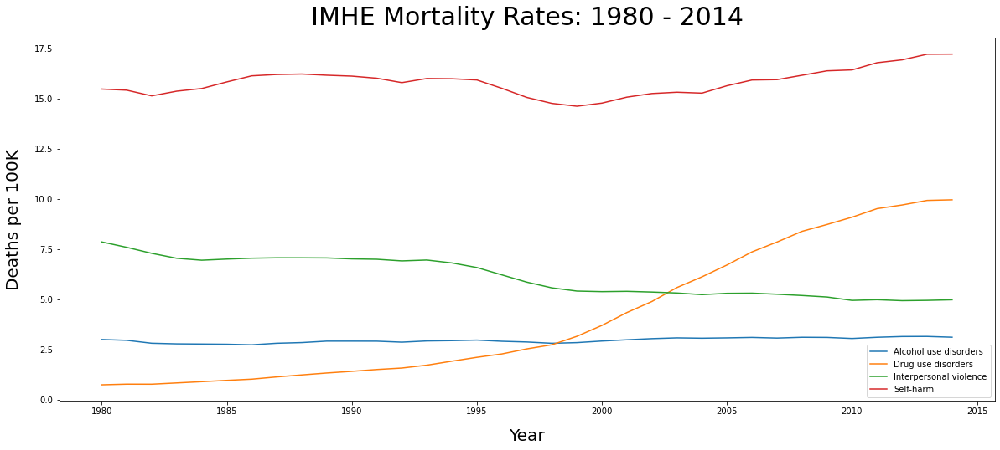

In [4]:
#https://scentellegher.github.io/programming/2017/07/15/pandas-groupby-multiple-columns-plot.html
fig, ax = plt.subplots(1, 1, figsize=(20, 8))
all_sub_inj_mortality.groupby(['year_id', 'cause_name']).mean()['mx'].unstack().plot(ax=ax)
ax.set_ylabel('Deaths per 100K', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_xlabel('Year', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_title('IMHE Mortality Rates: 1980 - 2014', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)

ax.legend();

#### Figure Summary

Of all four mortality categories contained in the IMHE dataset, the average rate of death by Alcohol Use Disorders has remained relatively constant. Interpersonal violence has, on average, gone down. The rate of deaths by Self-harm is not a perfect horizontal line, but has remained higher than all four other causes, and has appeared to have spiked after a dip in 1999/2000. Deaths from drug use disorders have increased consistently and significantly despite their starting rate being the lowest of the four causes. 

However, this graph represents the average rate over time, and does not show individual counties, or the rate of change. Further graphs will investigate further

In [115]:
selfharm_mortality.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 331065 entries, 0 to 331064
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   location_name  331065 non-null  object 
 1   FIPS           331065 non-null  int64  
 2   cause_name     331065 non-null  object 
 3   sex            331065 non-null  object 
 4   year_id        331065 non-null  int64  
 5   mx             331065 non-null  float64
 6   state          331065 non-null  object 
 7   UID            331065 non-null  object 
 8   UID_2          331065 non-null  object 
dtypes: float64(1), int64(2), object(6)
memory usage: 22.7+ MB


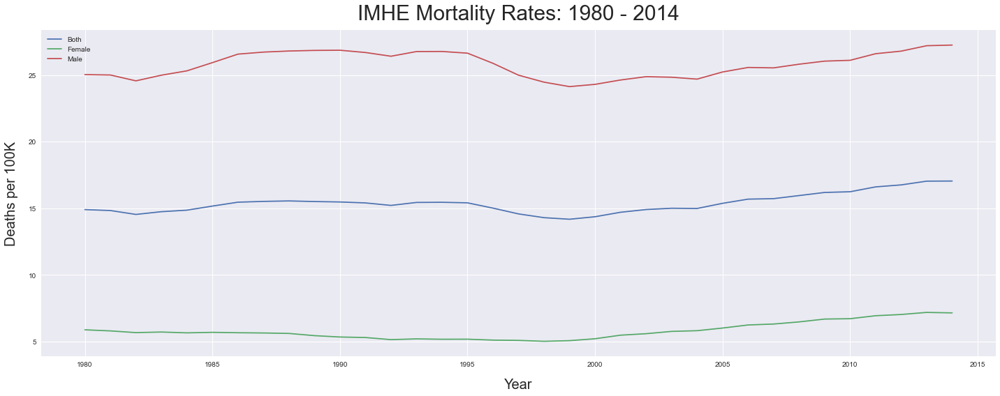

In [13]:
plt.style.use('seaborn')
fig, ax = plt.subplots(1, 1, figsize=(20, 8))
selfharm_mortality.groupby(['year_id', 'sex']).mean()['mx'].unstack().plot(ax=ax)
ax.set_ylabel('Deaths per 100K', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_xlabel('Year', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_title('IMHE Mortality Rates: 1980 - 2014', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
plt.legend(loc='best')

plt.tight_layout();

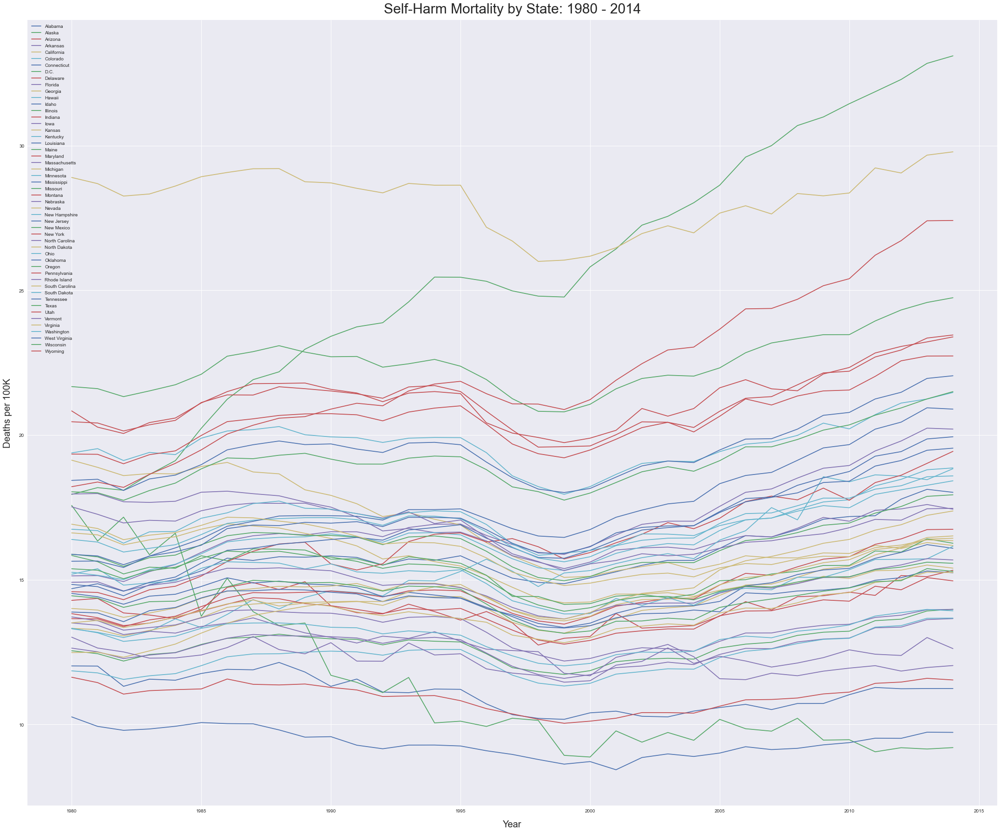

In [19]:
fig, ax = plt.subplots(1, 1, figsize=(30, 25))
selfharm_mortality.groupby(['year_id', 'state']).mean()['mx'].unstack().plot(ax=ax)
ax.set_ylabel('Deaths per 100K', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_xlabel('Year', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_title('Self-Harm Mortality by State: 1980 - 2014', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
plt.legend(loc='best')
plt.tight_layout();

In [15]:
selfharm_mortality_both = selfharm_mortality[selfharm_mortality['sex'] == 'Both']
selfharm_mortality_male = selfharm_mortality[selfharm_mortality['sex'] == 'Male']
selfharm_mortality_female = selfharm_mortality[selfharm_mortality['sex'] == 'Female']

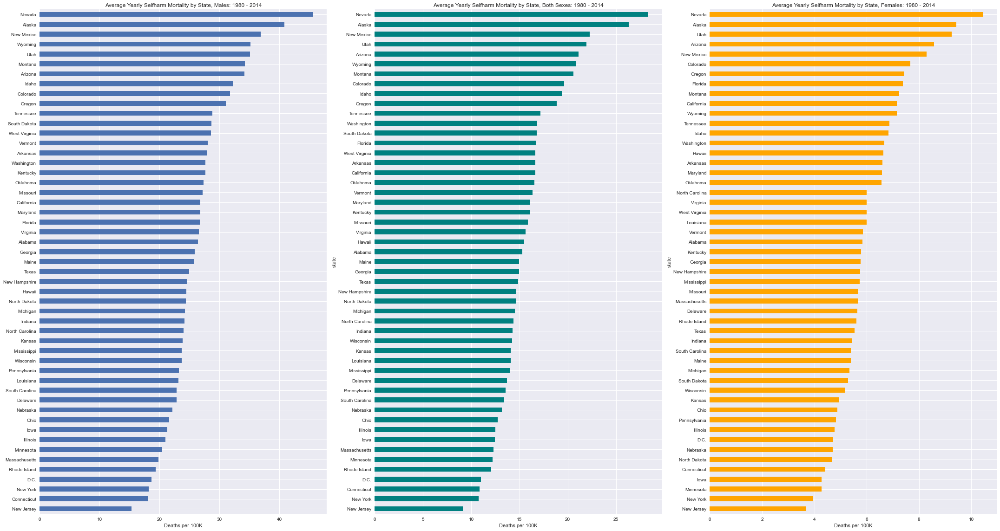

In [18]:
fig, ax = plt.subplots(1, 3, figsize=(30, 16))

selfharm_mortality_male.groupby(['state']).mean()['mx'].sort_values(ascending=True).plot(ax=ax[0], kind='barh')
ax[0].set_title('Average Yearly Selfharm Mortality by State, Males: 1980 - 2014')
ax[0].set_xlabel('Deaths per 100K')
ax[0].set_ylabel(None)

selfharm_mortality_both.groupby(['state']).mean()['mx'].sort_values(ascending=True).plot(ax=ax[1], kind='barh', color='teal')
ax[1].set_title('Average Yearly Selfharm Mortality by State, Both Sexes: 1980 - 2014')
ax[1].set_xlabel('Deaths per 100K')
ax[0].set_ylabel(None)


selfharm_mortality_female.groupby(['state']).mean()['mx'].sort_values(ascending=True).plot(ax=ax[2], kind='barh', color='orange')
ax[2].set_title('Average Yearly Selfharm Mortality by State, Females: 1980 - 2014')
ax[2].set_xlabel('Deaths per 100K')
ax[0].set_ylabel(None)

plt.tight_layout();

### Figure Summary
At first glance the yearly state average graphs look nearly identical, but on closer inspection, one notices a few things:

1) Men die from self-harm at much higher rates than women
2) The sorted values mean that states rank differently. For example, North Carolina ranks much higher for female self harm mortality compared to other states than it does for male self harm mortality compared to other states. 

This is an average of all the years though, so to understand further we'd want to look at each individual state over time. 

In [60]:
selfharm_mortality.describe() # the max mortality rate per 100K is 162!?!?, clearly an outlier, but it still makes you wonder what's going on

,FIPS,year_id,mx
count,331065.000000,331065.00000,331065.000000
mean,30277.779575,1997.00000,15.660113
std,15239.058494,10.09952,9.606918
min,11.000000,1980.00000,1.022797
25%,18161.000000,1988.00000,6.572495
50%,29165.000000,1997.00000,14.570645
75%,45075.000000,2006.00000,22.121253
max,56045.000000,2014.00000,162.268931


In [25]:
alcohol_use_binge

,FIPS,county_name,state,county_state,year,sex,year_metric_category,UID,UID_2,alcohol_binge,alcohol_prop_binge
0,01001,Autauga County,Alabama,"Autauga County, Alabama",2002,Both,2002 Both Sexes,01001-2002,01001-Both-2002,13.6,34.5
1,01003,Baldwin County,Alabama,"Baldwin County, Alabama",2002,Both,2002 Both Sexes,01003-2002,01003-Both-2002,17.9,33.2
2,01005,Barbour County,Alabama,"Barbour County, Alabama",2002,Both,2002 Both Sexes,01005-2002,01005-Both-2002,12.8,35.5
3,01007,Bibb County,Alabama,"Bibb County, Alabama",2002,Both,2002 Both Sexes,01007-2002,01007-Both-2002,11.3,36.4
4,01009,Blount County,Alabama,"Blount County, Alabama",2002,Both,2002 Both Sexes,01009-2002,01009-Both-2002,10.2,31.9
...,...,...,...,...,...,...,...,...,...,...,...
778861,56037,Sweetwater County,Wyoming,"Sweetwater County, Wyoming",2012,Male,2012 Males,56037-2012,56037-Male-2012,27.7,43.8
778862,56039,Teton County,Wyoming,"Teton County, Wyoming",2012,Male,2012 Males,56039-2012,56039-Male-2012,32.5,41.1
778863,56041,Uinta County,Wyoming,"Uinta County, Wyoming",2012,Male,2012 Males,56041-2012,56041-Male-2012,20.9,48.1
778864,56043,Washakie County,Wyoming,"Washakie County, Wyoming",2012,Male,2012 Males,56043-2012,56043-Male-2012,25.4,40.5


In [22]:
selfharm_mortality_female.sort_values(by='mx', ascending=False)

,location_name,FIPS,cause_name,sex,year_id,mx,state,UID,UID_2
30729,Kusilvak Census Area,02158,Self-harm,Female,2014,36.151892,Alaska,2158-2014,2158-Female-2014
30728,Kusilvak Census Area,02158,Self-harm,Female,2013,35.459602,Alaska,2158-2013,2158-Female-2013
30727,Kusilvak Census Area,02158,Self-harm,Female,2012,33.924934,Alaska,2158-2012,2158-Female-2012
30726,Kusilvak Census Area,02158,Self-harm,Female,2011,33.287688,Alaska,2158-2011,2158-Female-2011
30725,Kusilvak Census Area,02158,Self-harm,Female,2010,32.479674,Alaska,2158-2010,2158-Female-2010
...,...,...,...,...,...,...,...,...,...
150309,Kenedy County,48261,Self-harm,Female,1999,1.601953,Texas,48261-1999,48261-Female-1999
150308,Kenedy County,48261,Self-harm,Female,1998,1.601756,Texas,48261-1998,48261-Female-1998
204077,Baker County,13007,Self-harm,Female,2007,1.243094,Georgia,13007-2007,13007-Female-2007
234518,McCook County,46087,Self-harm,Female,1998,1.240766,South Dakota,46087-1998,46087-Female-1998


In [62]:
selfharm_mortality.sort_values(by='mx', ascending=False) # there is a particular county in alaska that has very selfharm mortality rates

,location_name,FIPS,cause_name,sex,year_id,mx,state,UID,UID_2
30693,Kusilvak Census Area,2158,Self-harm,Male,2013,162.268931,Alaska,2158-2013,2158-Male-2013
30694,Kusilvak Census Area,2158,Self-harm,Male,2014,157.508651,Alaska,2158-2014,2158-Male-2014
30692,Kusilvak Census Area,2158,Self-harm,Male,2012,154.866084,Alaska,2158-2012,2158-Male-2012
30690,Kusilvak Census Area,2158,Self-harm,Male,2010,150.818258,Alaska,2158-2010,2158-Male-2010
30691,Kusilvak Census Area,2158,Self-harm,Male,2011,150.440352,Alaska,2158-2011,2158-Male-2011
...,...,...,...,...,...,...,...,...,...
150309,Kenedy County,48261,Self-harm,Female,1999,1.601953,Texas,48261-1999,48261-Female-1999
150308,Kenedy County,48261,Self-harm,Female,1998,1.601756,Texas,48261-1998,48261-Female-1998
204077,Baker County,13007,Self-harm,Female,2007,1.243094,Georgia,13007-2007,13007-Female-2007
234518,McCook County,46087,Self-harm,Female,1998,1.240766,South Dakota,46087-1998,46087-Female-1998


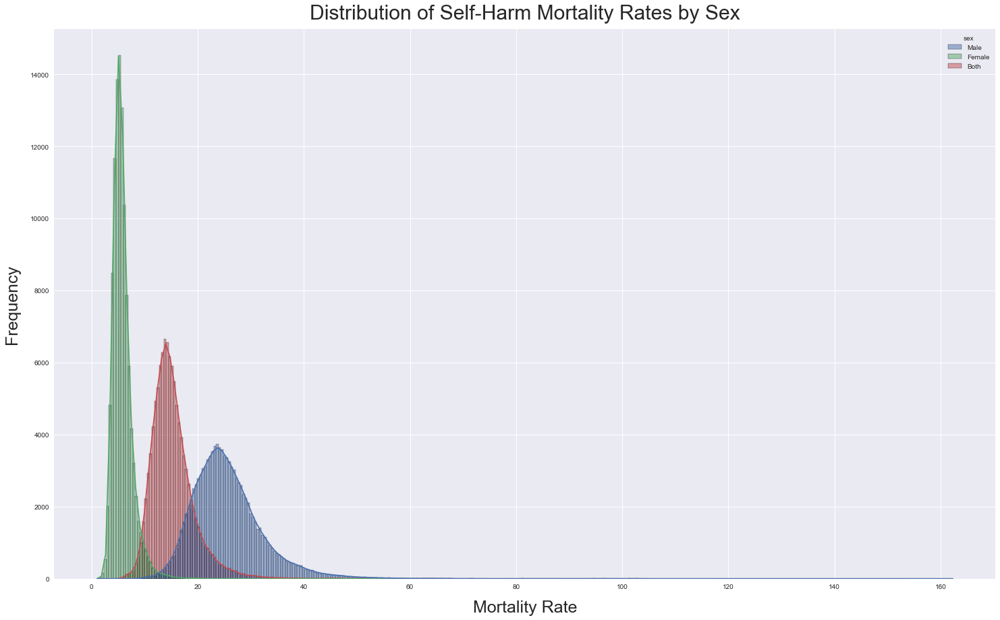

In [64]:
plt.style.use('seaborn')
sns.fig, ax = plt.subplots(1, 1, figsize=(25, 15))
ax.set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax.set_xlabel('Mortality Rate', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax.set_title('Distribution of Self-Harm Mortality Rates by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=selfharm_mortality, x='mx', hue='sex', kde=True, ax=ax);

## Let's put it on a Map!

Oftentimes the best way to identify patterns and trends is to visualize it. Since this is a county level dataset, it makes sense to view this as a map.

### I've commented out the plotly express stuff because the EDA file I uploaded to github kept crashing and at one point a push was rejected. Uncomment to run plotly choropleths

In [4]:
# import plotly.express as px
# from urllib.request import urlopen
# import json

# with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#     geo_counties = json.load(response)

In [122]:
# create an alaska dataframe from self harm mortality
selfharm_mortality_AK = selfharm_mortality[selfharm_mortality['state'] == 'Alaska']
selfharm_mortality_AK.sort_values(by='mx', ascending=False)

,location_name,FIPS,cause_name,sex,year_id,mx,state,UID,UID_2
30693,Kusilvak Census Area,02158,Self-harm,Male,2013,162.268931,Alaska,2158-2013,2158-Male-2013
30694,Kusilvak Census Area,02158,Self-harm,Male,2014,157.508651,Alaska,2158-2014,2158-Male-2014
30692,Kusilvak Census Area,02158,Self-harm,Male,2012,154.866084,Alaska,2158-2012,2158-Male-2012
30690,Kusilvak Census Area,02158,Self-harm,Male,2010,150.818258,Alaska,2158-2010,2158-Male-2010
30691,Kusilvak Census Area,02158,Self-harm,Male,2011,150.440352,Alaska,2158-2011,2158-Male-2011
...,...,...,...,...,...,...,...,...,...
30606,Kodiak Island Borough,02150,Self-harm,Female,1996,4.352881,Alaska,2150-1996,2150-Female-1996
30608,Kodiak Island Borough,02150,Self-harm,Female,1998,4.347773,Alaska,2150-1998,2150-Female-1998
30603,Kodiak Island Borough,02150,Self-harm,Female,1993,4.322209,Alaska,2150-1993,2150-Female-1993
30602,Kodiak Island Borough,02150,Self-harm,Female,1992,4.316315,Alaska,2150-1992,2150-Female-1992


In [130]:
# https://community.plotly.com/t/custom-choropleth-map-with-time-slider-plotly-express/42321
px.choropleth(
        data_frame=selfharm_mortality_AK,
        locations='FIPS', geojson=geo_counties,
        width=900, height=600,
        #animation_frame='year_id',
        scope='usa',
        color='mx',
        title="Self-harm Mortality Rate by County - 1980")

In [138]:
# get some choropletsh of whole US, 1980, 1995, 2005, 2014
selfharm_mortality_both_1980 = selfharm_mortality[(selfharm_mortality['year_id'] == 1980) & (selfharm_mortality['sex'] == 'Both')]
selfharm_mortality_both_1995 = selfharm_mortality[(selfharm_mortality['year_id'] == 1995) & (selfharm_mortality['sex'] == 'Both')]
selfharm_mortality_both_2005 = selfharm_mortality[(selfharm_mortality['year_id'] == 2005) & (selfharm_mortality['sex'] == 'Both')]
selfharm_mortality_both_2014 = selfharm_mortality[(selfharm_mortality['year_id'] == 2014) & (selfharm_mortality['sex'] == 'Both')]

## Investigating the Alcohol Use Data

Looking at Distributions and vizualizations of this dataset alone, before combining with teh self-harm mortality.

In [5]:
alcohol_any_ca = alcohol_use_any[(alcohol_use_any['state'] == 'California')]
alcohol_any_ca

,FIPS,county_name,state,county_state,year,sex,year_metric_category,UID,UID_2,alcohol_any
157,06001,Alameda County,California,"Alameda County, California",2002,Both,2002 Both Sexes,06001-2002,06001-Both-2002,60.7
158,06003,Alpine County,California,"Alpine County, California",2002,Both,2002 Both Sexes,06003-2002,06003-Both-2002,44.4
159,06005,Amador County,California,"Amador County, California",2002,Both,2002 Both Sexes,06005-2002,06005-Both-2002,63.0
160,06007,Butte County,California,"Butte County, California",2002,Both,2002 Both Sexes,06007-2002,06007-Both-2002,57.9
161,06009,Calaveras County,California,"Calaveras County, California",2002,Both,2002 Both Sexes,06009-2002,06009-Both-2002,65.0
...,...,...,...,...,...,...,...,...,...,...
96274,06107,Tulare County,California,"Tulare County, California",2012,Male,2012 Males,06107-2012,06107-Male-2012,56.0
96275,06109,Tuolumne County,California,"Tuolumne County, California",2012,Male,2012 Males,06109-2012,06109-Male-2012,61.9
96276,06111,Ventura County,California,"Ventura County, California",2012,Male,2012 Males,06111-2012,06111-Male-2012,66.9
96277,06113,Yolo County,California,"Yolo County, California",2012,Male,2012 Males,06113-2012,06113-Male-2012,69.8


In [17]:
alcohol_use_any['state'].value_counts().count()

48

In [9]:
alcohol_use_heavy_both = alcohol_use_heavy[alcohol_use_heavy['sex'] == 'Both']
alcohol_use_binge_both = alcohol_use_binge[alcohol_use_binge['sex'] == 'Both']

0

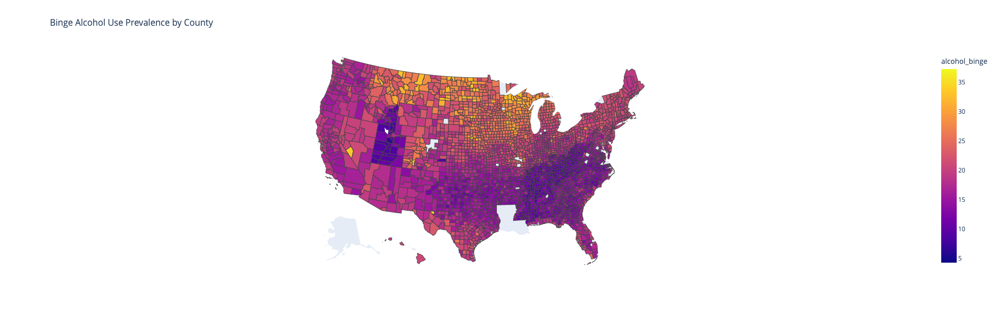

In [19]:
# https://community.plotly.com/t/custom-choropleth-map-with-time-slider-plotly-express/42321
# at first had many plotly express choropleths, but this made EDA notebook too large. 

# all images grabbed and used in presentation simply use this cell and swap out the data_frame and color variables for export
px.choropleth(
        data_frame=alcohol_use_binge_both,
        locations='FIPS', geojson=geo_counties,
        width=900, height=600,
        #animation_frame='year_id',
        scope='usa',
        color='alcohol_binge',
        title="Binge Alcohol Use Prevalence by County")

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(30, 25))
alcohol_use_any.groupby(['year_id', 'state']).mean()['mx'].unstack().plot(ax=ax)
ax.set_ylabel('Deaths per 100K', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_xlabel('Year', fontdict={'fontsize': 20, 'fontweight': 8}, labelpad=15)
ax.set_title('Self-Harm Mortality by State: 1980 - 2014', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
plt.legend(loc='best')
plt.tight_layout();

In [1]:
alcohol_use_any.groupby(['sex', 'year']).describe()

NameError: name 'alcohol_use_any' is not defined

In [ ]:
alcohol_use_heavy.groupby()

In [143]:
alcohol_use_heavy.groupby(['sex', 'year']).describe().round(2)

alcohol_heavy                                           \
                    count   mean   std  min  25%   50%   75%   max   
sex    year                                                          
Both   2005       17977.0   7.42  2.09  1.7  5.4   7.6   8.7  15.9   
       2006       17977.0   7.68  2.13  1.6  5.6   7.7   9.3  15.7   
       2007       17977.0   8.09  2.29  1.8  6.1   8.1   9.3  17.3   
       2008       17977.0   8.33  2.40  2.2  6.2   8.5   9.7  18.3   
       2009       17977.0   8.14  2.45  2.2  6.2   8.2   9.3  19.7   
       2010       17977.0   8.35  2.56  2.1  6.3   8.4   9.8  21.6   
       2011       17977.0   9.45  2.82  2.4  7.2   9.6  10.9  23.3   
       2012       17977.0   9.01  2.68  2.4  6.9   8.9  10.3  22.4   
Female 2005       17977.0   5.05  2.04  0.5  3.6   4.6   6.4  14.5   
       2006       17977.0   5.33  2.02  0.6  3.9   5.0   6.6  15.3   
       2007       17977.0   5.68  2.23  0.7  4.2   5.6   7.1  15.6   
       2008       17977.0   5.84  2.22  0.7  4.2   5.6   7.4  17.8   
       2009       17977.0   5.70  2.17  0.8  3.8   5.5   7.1  19.4   
       2010       17977.0   5.86  2.26  0.9  3.9   5.9   7.2  21.8   
       2011       17977.0   6.72  2.56  1.0  4.7   6.7   8.5  23.3   
       2012       17977.0   6.42  2.45  1.0  4.3   6.4   8.0  22.2   
Male   2005       17977.0   9.88  2.57  2.5  7.7   9.9  12.0  20.7   
       2006       17977.0  10.13  2.72  2.4  7.6  10.0  11.6  23.3   
       2007       17977.0  10.60  2.93  2.7  8.3  10.1  12.3  25.8   
       2008       17977.0  10.92  3.26  2.7  8.4  10.5  12.6  29.2   
       2009       17977.0  10.66  3.37  2.6  8.2  10.2  11.8  31.3   
       2010       17977.0  10.92  3.57  2.6  8.5  10.3  11.8  33.7   
       2011       17977.0  12.30  4.02  2.7  9.6  11.7  13.6  37.3   
       2012       17977.0  11.68  3.77  3.2  9.1  11.3  12.9  35.9   

            alcohol_prop_heavy                                            
                         count   mean   std  min   25%   50%   75%   max  
sex    year                                                               
Both   2005            17977.0  15.40  7.33  5.8  11.8  14.1  16.8  73.9  
       2006            17977.0  15.47  7.31  5.7  11.9  14.2  16.9  73.9  
       2007            17977.0  15.57  7.30  5.6  12.1  14.3  17.0  73.9  
       2008            17977.0  15.67  7.29  7.2  12.3  14.5  17.0  73.9  
       2009            17977.0  15.66  7.31  5.8  12.2  14.4  17.0  73.9  
       2010            17977.0  15.70  7.32  5.5  12.3  14.5  17.0  73.9  
       2011            17977.0  16.00  7.34  6.7  12.3  15.0  17.6  73.9  
       2012            17977.0  15.89  7.33  5.9  12.3  14.9  17.4  73.9  
Female 2005            17977.0  14.81  7.62  4.3  10.6  13.6  16.7  73.9  
       2006            17977.0  14.90  7.57  4.1  10.6  13.6  16.7  73.9  
       2007            17977.0  15.00  7.52  5.1  10.9  13.7  16.8  73.9  
       2008            17977.0  15.08  7.48  5.0  11.1  13.8  16.8  73.9  
       2009            17977.0  15.09  7.48  5.2  11.1  13.8  16.8  73.9  
       2010            17977.0  15.14  7.47  5.1  11.1  13.8  16.8  73.9  
       2011            17977.0  15.36  7.40  5.7  11.5  14.2  16.9  73.9  
       2012            17977.0  15.33  7.42  5.6  11.4  14.1  16.9  73.9  
Male   2005            17977.0  15.80  7.30  6.4  12.3  14.7  17.3  73.9  
       2006            17977.0  15.86  7.31  5.9  12.3  14.9  17.4  73.9  
       2007            17977.0  15.98  7.33  5.6  12.3  15.0  17.6  73.9  
       2008            17977.0  16.09  7.36  6.9  12.3  15.0  17.9  73.9  
       2009            17977.0  16.04  7.38  5.3  12.3  15.0  17.8  73.9  
       2010            17977.0  16.09  7.41  4.7  12.3  15.0  17.9  80.0  
       2011            17977.0  16.46  7.57  6.0  12.3  15.2  18.4  90.7  
       2012            17977.0  16.28  7.49  5.2  12.3  15.1  18.2  89.0

In [145]:
alcohol_use_binge.groupby(['sex', 'year']).describe().round(2)

alcohol_binge                                            \
                    count   mean   std  min   25%   50%   75%   max   
sex    year                                                           
Both   2002       23602.0  18.51  4.21  4.3  14.5  18.4  22.0  33.0   
       2003       23602.0  18.71  4.14  5.1  14.7  18.8  21.9  33.6   
       2004       23602.0  17.89  4.03  5.5  13.7  18.0  21.1  32.4   
       2005       23602.0  17.72  3.96  5.2  13.7  17.7  21.0  31.6   
       2006       23602.0  17.74  3.87  5.2  13.8  17.7  20.7  31.3   
       2007       23602.0  18.13  3.90  5.6  14.1  18.6  21.2  31.9   
       2008       23602.0  18.31  4.00  5.5  14.2  18.3  21.5  31.9   
       2009       23602.0  18.42  4.11  5.6  14.3  18.6  22.1  32.4   
       2010       23602.0  18.54  4.05  5.5  14.5  18.8  21.6  34.5   
       2011       23602.0  19.80  4.38  5.9  15.6  20.1  23.0  37.3   
       2012       23602.0  19.37  4.40  5.9  14.9  19.5  22.6  36.0   
Female 2002       23602.0  11.40  3.34  1.5   8.4  11.4  14.2  24.1   
       2003       23602.0  11.61  3.36  2.0   8.4  11.7  14.4  24.6   
       2004       23602.0  11.08  3.28  2.1   7.7  11.1  13.9  22.6   
       2005       23602.0  10.91  3.17  2.1   7.8  11.1  13.5  22.3   
       2006       23602.0  11.09  3.02  2.5   8.3  11.3  13.5  22.8   
       2007       23602.0  11.49  3.19  2.9   8.6  11.5  14.3  23.9   
       2008       23602.0  11.49  3.25  3.1   8.4  11.6  14.1  24.2   
       2009       23602.0  11.52  3.39  3.1   8.0  11.7  14.8  25.5   
       2010       23602.0  11.77  3.44  3.1   8.2  11.9  14.5  27.7   
       2011       23602.0  12.68  3.66  3.3   9.2  12.9  15.6  30.1   
       2012       23602.0  12.55  3.81  3.2   9.0  12.6  15.6  29.3   
Male   2002       23602.0  25.89  5.35  7.2  21.4  26.1  29.4  44.6   
       2003       23602.0  26.07  5.15  8.3  21.3  26.5  29.4  44.7   
       2004       23602.0  24.94  4.98  8.0  20.4  25.1  28.5  42.6   
       2005       23602.0  24.77  5.00  7.1  20.1  24.9  27.7  43.0   
       2006       23602.0  24.63  5.02  6.9  19.8  24.7  28.1  42.0   
       2007       23602.0  25.01  4.93  7.6  20.4  25.4  28.7  42.0   
       2008       23602.0  25.39  5.21  7.3  20.5  25.5  30.1  45.1   
       2009       23602.0  25.56  5.31  7.4  20.6  25.8  30.2  46.4   
       2010       23602.0  25.58  5.18  7.4  20.8  25.9  30.5  46.4   
       2011       23602.0  27.16  5.75  7.7  22.3  27.0  32.2  48.7   
       2012       23602.0  26.43  5.59  7.7  21.2  26.1  29.8  47.2   

            alcohol_prop_binge                                                
                         count   mean    std   min   25%   50%    75%    max  
sex    year                                                                   
Both   2002            23602.0  34.08  10.24  16.3  26.9  33.6  39.10   92.8  
       2003            23602.0  34.03  10.22  16.3  26.9  33.4  39.00   92.8  
       2004            23602.0  33.99  10.22  16.3  26.9  33.3  38.90   92.8  
       2005            23602.0  33.89  10.22  16.3  26.9  32.9  38.80   92.8  
       2006            23602.0  33.88  10.22  16.3  26.9  32.9  38.80   92.8  
       2007            23602.0  33.95  10.21  16.3  26.9  33.0  38.80   92.8  
       2008            23602.0  33.98  10.22  16.3  26.9  33.2  38.90   92.8  
       2009            23602.0  34.05  10.23  16.3  27.0  33.3  39.00   92.8  
       2010            23602.0  34.07  10.23  16.3  27.1  33.4  39.00   92.8  
       2011            23602.0  34.29  10.29  16.3  27.2  34.0  39.40   92.8  
       2012            23602.0  34.24  10.30  16.3  27.1  33.8  39.40   92.8  
Female 2002            23602.0  32.78  10.68  12.5  25.0  31.0  38.40   92.8  
       2003            23602.0  32.76  10.69  13.0  24.8  31.0  38.40   92.8  
       2004            23602.0  32.73  10.70  12.2  24.8  31.0  38.40   92.8  
       2005            23602.0  32.63  10.78  11.6  24.5  30.9  38.40   92.8  
       2006            23602.0  3

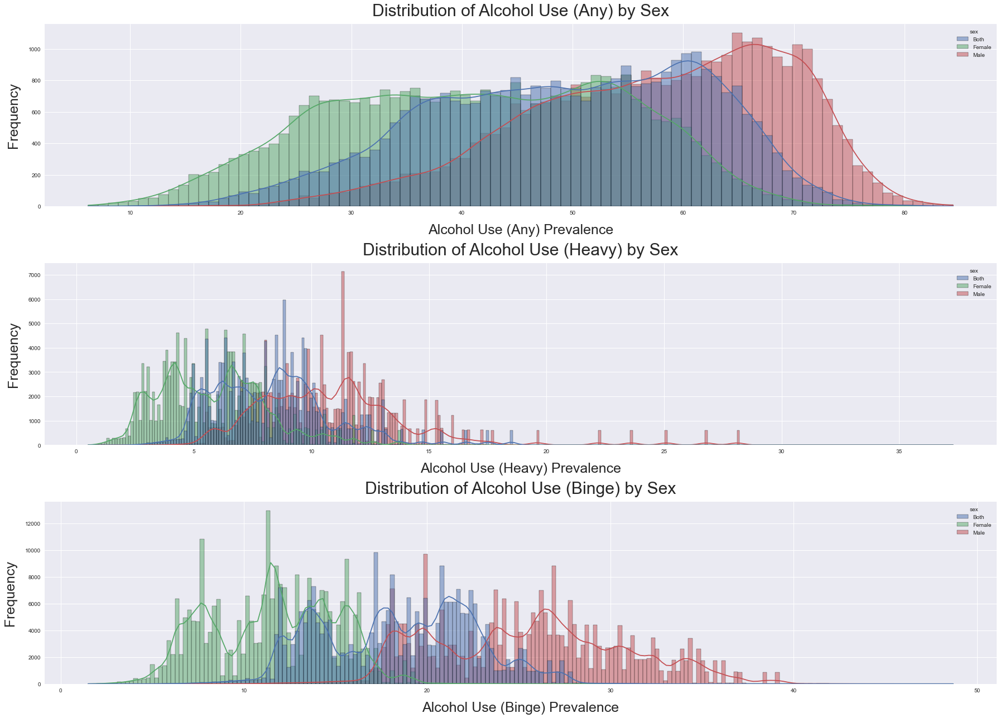

In [101]:
sns.fig, ax = plt.subplots(3, 1, figsize=(25, 18))
ax[0].set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[0].set_xlabel('Alcohol Use (Any) Prevalence', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[0].set_title('Distribution of Alcohol Use (Any) by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=alcohol_use_any, x='alcohol_any', hue='sex', kde=True, ax=ax[0])

ax[1].set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[1].set_xlabel('Alcohol Use (Heavy) Prevalence', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[1].set_title('Distribution of Alcohol Use (Heavy) by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=alcohol_use_heavy, x='alcohol_heavy', hue='sex', kde=True, ax=ax[1])


ax[2].set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[2].set_xlabel('Alcohol Use (Binge) Prevalence', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[2].set_title('Distribution of Alcohol Use (Binge) by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=alcohol_use_binge, x='alcohol_binge', hue='sex', kde=True, ax=ax[2])

plt.tight_layout();

### Alcohol Prevalence Histplot Summary:

None of these are particularly *normal* distributions. 

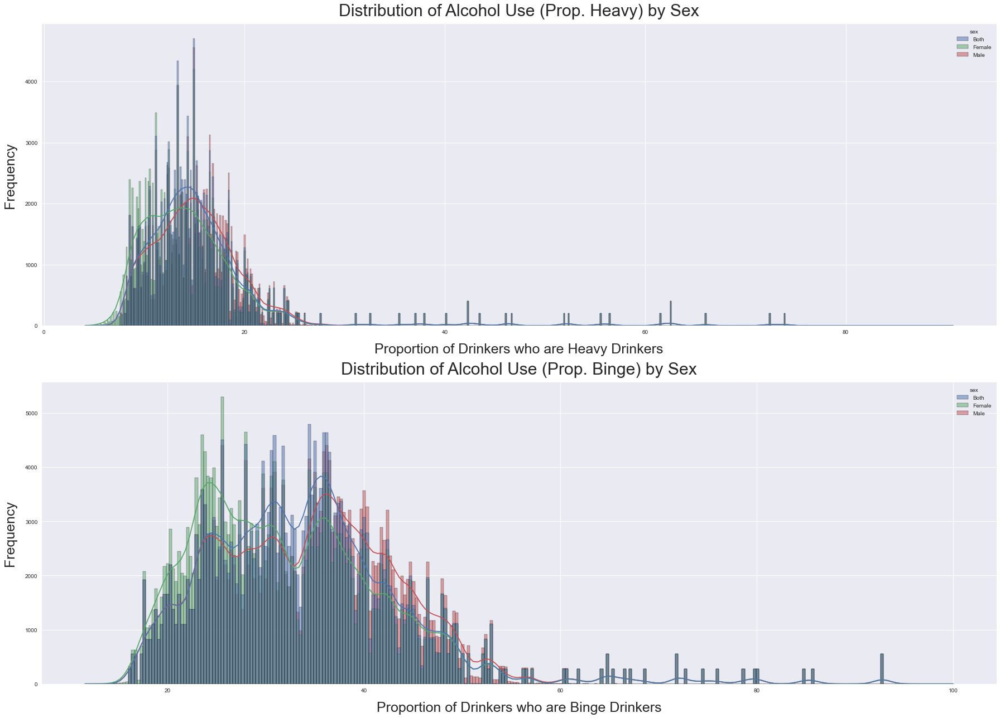

In [100]:
sns.fig, ax = plt.subplots(2, 1, figsize=(25, 18))
ax[0].set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[0].set_xlabel('Proportion of Drinkers who are Heavy Drinkers', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[0].set_title('Distribution of Alcohol Use (Prop. Heavy) by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=alcohol_use_heavy, x='alcohol_prop_heavy', hue='sex', kde=True, ax=ax[0])

ax[1].set_ylabel('Frequency', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[1].set_xlabel('Proportion of Drinkers who are Binge Drinkers', fontdict={'fontsize': 25, 'fontweight': 25}, labelpad=15)
ax[1].set_title('Distribution of Alcohol Use (Prop. Binge) by Sex', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.histplot(data=alcohol_use_binge, x='alcohol_prop_binge', hue='sex', kde=True, ax=ax[1])

plt.tight_layout();

# Investigating the Intersection of Selfharm Mortality and Alcohol Use

In [95]:
harm_alcohol_any.groupby(['sex', 'year_id'])['mx', 'alcohol_any'].describe().round(2)

<ipython-input-95-d23069eec840>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  harm_alcohol_any.groupby(['sex', 'year_id'])['mx', 'alcohol_any'].describe().round(2)


mx                                                  \
                 count   mean   std   min    25%    50%    75%     max   
sex    year_id                                                           
Both   2002     2697.0  14.64  3.88  5.86  12.15  14.04  16.38   50.90   
       2003     2697.0  14.74  3.96  5.84  12.25  14.12  16.42   52.05   
       2004     2697.0  14.72  3.97  5.60  12.21  14.09  16.47   52.52   
       2005     2697.0  15.11  4.12  5.90  12.52  14.50  17.00   57.18   
       2006     2697.0  15.40  4.24  5.98  12.69  14.74  17.27   56.01   
       2007     2697.0  15.44  4.30  5.99  12.73  14.84  17.36   57.84   
       2008     2697.0  15.67  4.40  5.99  12.86  15.04  17.66   58.90   
       2009     2697.0  15.90  4.50  6.08  13.01  15.24  17.89   60.27   
       2010     2697.0  15.95  4.55  5.91  12.99  15.27  18.08   62.59   
       2011     2697.0  16.33  4.68  5.78  13.30  15.63  18.46   62.12   
       2012     2697.0  16.46  4.78  5.94  13.35  15.76  18.66   64.10   
Female 2002     2697.0   5.45  1.61  1.84   4.37   5.23   6.16   18.89   
       2003     2697.0   5.61  1.68  1.86   4.49   5.38   6.35   19.78   
       2004     2697.0   5.67  1.72  1.87   4.53   5.42   6.40   20.06   
       2005     2697.0   5.87  1.82  1.98   4.67   5.59   6.63   21.55   
       2006     2697.0   6.09  1.90  2.09   4.86   5.78   6.89   22.46   
       2007     2697.0   6.16  1.94  1.24   4.89   5.84   6.97   22.77   
       2008     2697.0   6.32  2.01  2.13   4.99   5.99   7.17   23.78   
       2009     2697.0   6.53  2.11  2.22   5.16   6.17   7.42   25.08   
       2010     2697.0   6.56  2.14  2.14   5.17   6.20   7.45   25.73   
       2011     2697.0   6.79  2.25  2.22   5.31   6.41   7.73   26.60   
       2012     2697.0   6.87  2.30  2.27   5.33   6.47   7.85   26.74   
Male   2002     2697.0  24.50  6.62  8.75  20.18  23.55  27.56   95.71   
       2003     2697.0  24.45  6.69  8.71  20.18  23.56  27.46   96.95   
       2004     2697.0  24.31  6.69  8.17  20.01  23.37  27.44   96.74   
       2005     2697.0  24.85  6.90  8.53  20.35  23.87  28.04  100.98   
       2006     2697.0  25.15  7.05  8.68  20.51  24.18  28.46  101.42   
       2007     2697.0  25.13  7.12  8.65  20.53  24.14  28.43  101.61   
       2008     2697.0  25.41  7.25  8.62  20.70  24.42  28.80  103.06   
       2009     2697.0  25.63  7.35  8.70  20.78  24.67  29.10  102.19   
       2010     2697.0  25.69  7.43  8.64  20.78  24.62  29.17  102.58   
       2011     2697.0  26.20  7.60  8.58  21.15  25.16  29.81  102.69   
       2012     2697.0  26.37  7.76  8.82  21.27  25.22  30.11  101.54   

               alcohol_any                                              
                     count   mean    std   min   25%   50%   75%   max  
sex    year_id                                                          
Both   2002         2697.0  47.95  13.15  11.7  38.4  48.8  59.0  78.3  
       2003         2697.0  49.29  12.71  14.3  40.1  49.8  60.0  78.6  
       2004         2697.0  48.15  12.49  13.2  39.0  48.7  58.6  77.4  
       2005         2697.0  48.80  12.25  11.0  39.8  49.4  59.1  77.4  
       2006         2697.0  48.69  12.32  11.2  39.6  49.5  59.0  78.0  
       2007         2697.0  49.35  12.09  12.0  40.4  50.3  59.4  77.7  
       2008         2697.0  49.86  11.94  11.3  41.1  50.8  59.7  76.9  
       2009         2697.0  49.68  12.22  10.6  41.0  50.9  59.9  77.0  
       2010         2697.0  49.90  11.95  10.5  41.2  50.8  60.0  75.6  
       2011         2697.0  50.89  11.79   9.6  42.4  51.8  60.8  75.9  
       2012         2697.0  49.79  11.62  11.0  41.3  50.4  59.6  74.9  
Female 2002         2697.0  39.28  13.80   6.2  28.4  39.4  50.8  76.0  
       2003         2697.0  40.63  13.55   8.1  30.2  40.5  52.0  75.9  
       2004         2697.0  39.60  13.20   7.7  29.4  39.5  50.7  74.4  
       2005         2697.0  40.51  13.05   7.9  30.4  40.5  51.3  74.1  
       2006         2697.0  40.78  13.00 

In [147]:
harm_alcohol_heavy.groupby(['sex', 'year_id'])['mx', 'alcohol_heavy', 'alcohol_prop_heavy'].describe().round(2)

<ipython-input-147-4357b7dd4178>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



mx                                                  \
                 count   mean   std   min    25%    50%    75%     max   
sex    year_id                                                           
Both   2005     2697.0  15.11  4.12  5.90  12.52  14.50  17.00   57.18   
       2006     2697.0  15.40  4.24  5.98  12.69  14.74  17.27   56.01   
       2007     2697.0  15.44  4.30  5.99  12.73  14.84  17.36   57.84   
       2008     2697.0  15.67  4.40  5.99  12.86  15.04  17.66   58.90   
       2009     2697.0  15.90  4.50  6.08  13.01  15.24  17.89   60.27   
       2010     2697.0  15.95  4.55  5.91  12.99  15.27  18.08   62.59   
       2011     2697.0  16.33  4.68  5.78  13.30  15.63  18.46   62.12   
       2012     2697.0  16.46  4.78  5.94  13.35  15.76  18.66   64.10   
Female 2005     2697.0   5.87  1.82  1.98   4.67   5.59   6.63   21.55   
       2006     2697.0   6.09  1.90  2.09   4.86   5.78   6.89   22.46   
       2007     2697.0   6.16  1.94  1.24   4.89   5.84   6.97   22.77   
       2008     2697.0   6.32  2.01  2.13   4.99   5.99   7.17   23.78   
       2009     2697.0   6.53  2.11  2.22   5.16   6.17   7.42   25.08   
       2010     2697.0   6.56  2.14  2.14   5.17   6.20   7.45   25.73   
       2011     2697.0   6.79  2.25  2.22   5.31   6.41   7.73   26.60   
       2012     2697.0   6.87  2.30  2.27   5.33   6.47   7.85   26.74   
Male   2005     2697.0  24.85  6.90  8.53  20.35  23.87  28.04  100.98   
       2006     2697.0  25.15  7.05  8.68  20.51  24.18  28.46  101.42   
       2007     2697.0  25.13  7.12  8.65  20.53  24.14  28.43  101.61   
       2008     2697.0  25.41  7.25  8.62  20.70  24.42  28.80  103.06   
       2009     2697.0  25.63  7.35  8.70  20.78  24.67  29.10  102.19   
       2010     2697.0  25.69  7.43  8.64  20.78  24.62  29.17  102.58   
       2011     2697.0  26.20  7.60  8.58  21.15  25.16  29.81  102.69   
       2012     2697.0  26.37  7.76  8.82  21.27  25.22  30.11  101.54   

               alcohol_heavy                                           \
                       count   mean   std  min  25%   50%   75%   max   
sex    year_id                                                          
Both   2005           2697.0   6.38  2.04  1.7  5.0   6.2   7.5  15.9   
       2006           2697.0   6.59  2.14  1.6  5.1   6.4   7.8  15.7   
       2007           2697.0   7.01  2.24  1.8  5.5   6.8   8.3  17.3   
       2008           2697.0   7.38  2.32  2.2  5.7   7.1   8.8  18.3   
       2009           2697.0   7.27  2.32  2.2  5.6   7.0   8.6  19.7   
       2010           2697.0   7.46  2.41  2.1  5.7   7.2   8.9  21.6   
       2011           2697.0   8.54  2.71  2.4  6.6   8.2  10.2  23.3   
       2012           2697.0   8.04  2.64  2.4  6.1   7.7   9.6  22.4   
Female 2005           2697.0   3.96  1.87  0.5  2.6   3.7   5.1  14.5   
       2006           2697.0   4.24  2.01  0.6  2.7   3.9   5.4  15.3   
       2007           2697.0   4.54  2.11  0.7  3.0   4.2   5.8  15.6   
       2008           2697.0   4.81  2.22  0.7  3.2   4.5   6.1  17.8   
       2009           2697.0   4.83  2.28  0.8  3.1   4.5   6.2  19.4   
       2010           2697.0   5.04  2.42  0.9  3.3   4.7   6.4  21.8   
       2011           2697.0   5.78  2.68  1.0  3.8   5.4   7.4  23.3   
       2012           2697.0   5.52  2.67  1.0  3.6   5.1   7.1  22.2   
Male   2005           2697.0   8.88  2.47  2.5  7.1   8.7  10.3  20.7   
       2006           2697.0   9.03  2.56  2.4  7.2   8.9  10.5  23.3   
       2007           2697.0   9.56  2.67  2.7  7.8   9.4  11.0  25.8   
       2008           2697.0  10.04  2.78  2.7  8.0   9.8  11.6  29.2   
       2009           2697.0   9.80  2.74  2.6  7.9   9.5  11.3  31.3   
       2010           2697.0   9.98  2.84  2.6  8.0   9.7  11.5  33.7   
       2011           2697.0  11.40  3.23  2.7  9.1  11.1  13.1  37.3   
       2012           2697.0  10.66  3.09  3.2  8.5  10.4  12.4  35.9   

               alcohol_prop_heavy                

In [93]:
harm_alcohol_binge.groupby(['sex', 'year_id'])['mx', 'alcohol_binge', 'alcohol_prop_binge'].describe().round(2)

<ipython-input-93-ad78905f5a6e>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  harm_alcohol_binge.groupby(['sex', 'year_id'])['mx', 'alcohol_binge', 'alcohol_prop_binge'].describe().round(2)


mx                                                  \
                 count   mean   std   min    25%    50%    75%     max   
sex    year_id                                                           
Both   2002     2697.0  14.64  3.88  5.86  12.15  14.04  16.38   50.90   
       2003     2697.0  14.74  3.96  5.84  12.25  14.12  16.42   52.05   
       2004     2697.0  14.72  3.97  5.60  12.21  14.09  16.47   52.52   
       2005     2697.0  15.11  4.12  5.90  12.52  14.50  17.00   57.18   
       2006     2697.0  15.40  4.24  5.98  12.69  14.74  17.27   56.01   
       2007     2697.0  15.44  4.30  5.99  12.73  14.84  17.36   57.84   
       2008     2697.0  15.67  4.40  5.99  12.86  15.04  17.66   58.90   
       2009     2697.0  15.90  4.50  6.08  13.01  15.24  17.89   60.27   
       2010     2697.0  15.95  4.55  5.91  12.99  15.27  18.08   62.59   
       2011     2697.0  16.33  4.68  5.78  13.30  15.63  18.46   62.12   
       2012     2697.0  16.46  4.78  5.94  13.35  15.76  18.66   64.10   
Female 2002     2697.0   5.45  1.61  1.84   4.37   5.23   6.16   18.89   
       2003     2697.0   5.61  1.68  1.86   4.49   5.38   6.35   19.78   
       2004     2697.0   5.67  1.72  1.87   4.53   5.42   6.40   20.06   
       2005     2697.0   5.87  1.82  1.98   4.67   5.59   6.63   21.55   
       2006     2697.0   6.09  1.90  2.09   4.86   5.78   6.89   22.46   
       2007     2697.0   6.16  1.94  1.24   4.89   5.84   6.97   22.77   
       2008     2697.0   6.32  2.01  2.13   4.99   5.99   7.17   23.78   
       2009     2697.0   6.53  2.11  2.22   5.16   6.17   7.42   25.08   
       2010     2697.0   6.56  2.14  2.14   5.17   6.20   7.45   25.73   
       2011     2697.0   6.79  2.25  2.22   5.31   6.41   7.73   26.60   
       2012     2697.0   6.87  2.30  2.27   5.33   6.47   7.85   26.74   
Male   2002     2697.0  24.50  6.62  8.75  20.18  23.55  27.56   95.71   
       2003     2697.0  24.45  6.69  8.71  20.18  23.56  27.46   96.95   
       2004     2697.0  24.31  6.69  8.17  20.01  23.37  27.44   96.74   
       2005     2697.0  24.85  6.90  8.53  20.35  23.87  28.04  100.98   
       2006     2697.0  25.15  7.05  8.68  20.51  24.18  28.46  101.42   
       2007     2697.0  25.13  7.12  8.65  20.53  24.14  28.43  101.61   
       2008     2697.0  25.41  7.25  8.62  20.70  24.42  28.80  103.06   
       2009     2697.0  25.63  7.35  8.70  20.78  24.67  29.10  102.19   
       2010     2697.0  25.69  7.43  8.64  20.78  24.62  29.17  102.58   
       2011     2697.0  26.20  7.60  8.58  21.15  25.16  29.81  102.69   
       2012     2697.0  26.37  7.76  8.82  21.27  25.22  30.11  101.54   

               alcohol_binge         ...             alcohol_prop_binge  \
                       count   mean  ...   75%   max              count   
sex    year_id                       ...                                  
Both   2002           2697.0  16.82  ...  20.4  33.0             2697.0   
       2003           2697.0  17.11  ...  20.6  33.6             2697.0   
       2004           2697.0  16.48  ...  19.8  32.4             2697.0   
       2005           2697.0  16.35  ...  19.4  31.6             2697.0   
       2006           2697.0  16.31  ...  19.4  31.3             2697.0   
       2007           2697.0  16.76  ...  19.8  31.9             2697.0   
       2008           2697.0  17.07  ...  20.1  31.9             2697.0   
       2009           2697.0  17.24  ...  20.4  32.4             2697.0   
       2010           2697.0  17.43  ...  20.5  34.5             2697.0   
       2011           2697.0  18.69  ...  22.0  37.3             2697.0   
       2012           2697.0  18.15  ...  21.5  36.0             2697.0   
Female 2002           2697.0   9.79  ...  12.5  24.1             2697.0   
       2003           2697.0  10.08  ...  12.9  24.6             2697.0   
       2004           2697.0   9.72  ...  12.4  22.6             2697.0   
       2005           2697.0   9.61  ...  12.1  22.3             2697.0   
     

In [97]:
harm_alcohol_binge

,location_name,FIPS,cause_name,sex,year_id,mx,state,UID,UID_2,county_state_y,alcohol_binge,alcohol_prop_binge
22,Adams County,17001,Self-harm,Male,2002,19.723610,Illinois,17001-2002,17001-Male-2002,"Adams County, Illinois",29.3,45.6
23,Adams County,17001,Self-harm,Male,2003,19.560579,Illinois,17001-2003,17001-Male-2003,"Adams County, Illinois",29.4,45.0
24,Adams County,17001,Self-harm,Male,2004,19.175775,Illinois,17001-2004,17001-Male-2004,"Adams County, Illinois",27.9,43.7
25,Adams County,17001,Self-harm,Male,2005,20.508569,Illinois,17001-2005,17001-Male-2005,"Adams County, Illinois",28.0,43.4
26,Adams County,17001,Self-harm,Male,2006,19.711650,Illinois,17001-2006,17001-Male-2006,"Adams County, Illinois",28.6,44.1
...,...,...,...,...,...,...,...,...,...,...,...,...
331058,Wyoming County,54109,Self-harm,Both,2008,21.159870,West Virginia,54109-2008,54109-Both-2008,"Wyoming County, West Virginia",9.5,40.4
331059,Wyoming County,54109,Self-harm,Both,2009,21.284966,West Virginia,54109-2009,54109-Both-2009,"Wyoming County, West Virginia",9.5,41.9
331060,Wyoming County,54109,Self-harm,Both,2010,21.706674,West Virginia,54109-2010,54109-Both-2010,"Wyoming County, West Virginia",9.8,42.4
331061,Wyoming County,54109,Self-harm,Both,2011,22.570620,West Virginia,54109-2011,54109-Both-2011,"Wyoming County, West Virginia",10.2,43.8


In [98]:
harm_alcohol_binge.groupby(['state', 'sex'])['mx', 'alcohol_binge', 'alcohol_prop_binge'].describe().round(2)

<ipython-input-98-bfebba5d7463>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  harm_alcohol_binge.groupby(['state', 'sex'])['mx', 'alcohol_binge', 'alcohol_prop_binge'].describe().round(2)


mx                                            \
                        count   mean    std    min    25%    50%    75%   
state          sex                                                        
Delaware       Both      33.0  13.80   1.20  11.38  12.74  13.97  14.50   
               Female    33.0   5.95   0.50   4.95   5.53   6.01   6.28   
               Male      33.0  22.55   2.33  18.03  20.23  23.00  24.34   
Florida        Both     715.0  16.68   3.12   9.45  14.25  16.59  18.57   
               Female   715.0   7.83   1.88   3.42   6.54   7.70   8.87   
               Male     715.0  25.53   5.12  15.93  21.42  25.42  28.34   
Georgia        Both    1749.0  14.52   2.27   9.19  13.18  14.40  15.68   
               Female  1749.0   5.95   1.12   1.24   5.20   5.82   6.53   
               Male    1749.0  24.08   4.32  12.69  21.29  23.88  26.34   
Hawaii         Both      33.0  16.22   3.74  10.80  12.65  16.26  19.21   
               Female    33.0   8.08   1.59   5.94   6.35   8.29   9.28   
               Male      33.0  24.47   6.03  15.49  19.05  24.57  29.31   
Idaho          Both     484.0  20.06   4.00   8.09  17.68  19.40  22.19   
               Female   484.0   7.74   1.82   3.53   6.66   7.58   8.66   
               Male     484.0  32.39   7.04  12.78  28.24  31.03  36.16   
Illinois       Both    1111.0  12.78   2.27   7.87  11.29  12.56  14.19   
               Female  1111.0   5.05   1.02   3.11   4.23   4.96   5.68   
               Male    1111.0  20.82   3.96  12.61  18.21  20.42  23.21   
Indiana        Both    1001.0  15.06   2.71   8.69  13.17  14.69  16.75   
               Female  1001.0   6.14   1.29   3.72   5.23   5.96   6.83   
               Male    1001.0  24.59   4.63  13.60  21.33  24.13  27.64   
Iowa           Both    1089.0  12.57   1.98   5.60  11.18  12.66  13.93   
               Female  1089.0   4.55   0.95   2.61   3.87   4.45   5.09   
               Male    1089.0  20.90   3.54   8.17  18.42  20.96  23.36   
Kansas         Both    1155.0  14.83   2.38   7.82  12.88  14.81  16.58   
               Female  1155.0   5.39   1.01   1.68   4.66   5.29   6.00   
               Male    1155.0  24.53   4.29  13.63  20.95  24.48  27.69   
Kentucky       Both    1320.0  16.89   2.96   9.99  14.84  16.72  18.75   
               Female  1320.0   6.37   1.32   3.84   5.48   6.17   7.07   
               Male    1320.0  28.31   5.26  15.09  24.55  28.22  31.53   
Maine          Both     176.0  14.89   1.99  11.60  13.25  14.90  16.32   
               Female   176.0   5.59   0.70   4.03   5.05   5.60   6.06   
               Male     176.0  25.01   3.60  18.99  22.28  24.77  27.30   
Maryland       Both     242.0  16.57   3.43   9.13  15.07  17.02  18.68   
               Female   242.0   7.35   1.61   4.10   6.25   7.40   8.38   
               Male     242.0  26.64   5.71  14.52  24.61  27.40  30.01   
Massachusetts  Both     154.0  11.82   1.75   8.35  10.59  11.95  12.79   
               Female   154.0   5.72   0.84   4.32   5.12   5.54   6.30   
               Male     154.0  18.43   2.90  12.58  16.57  18.37  19.81   
Michigan       Both     891.0  15.11   2.94   8.52  13.14  14.73  16.96   
               Female   891.0   5.90   1.07   3.41   5.11   5.80   6.58   
               Male     891.0  24.50   5.10  12.99  21.03  24.05  27.95   
Minnesota      Both     946.0  12.54   2.28   8.16  10.85  11.98  13.86   
               Female   946.0   4.72   1.04   2.86   4.00   4.48   5.21   
               Male     946.0  20.43   3.74  12.61  17.69  19.44  22.77   
Mississippi    Both     902.0  14.51   2.43   9.28  12.89  14.19  15.64   
               Female   902.0   6.06   1.40   3.49   5.04   5.82   6.81   
               Male     902.0  24.10   4.17  13.33  21.32  23.81  26.32   
Missouri       Both    1199.0  16.27   2.47  10.55  14.45  16.25  17.96   
               Female  1199.0   6.13   1.24   3.53   5.24   6.02   6.92   
               Male    1199.0  27.10   4.50  14.51  

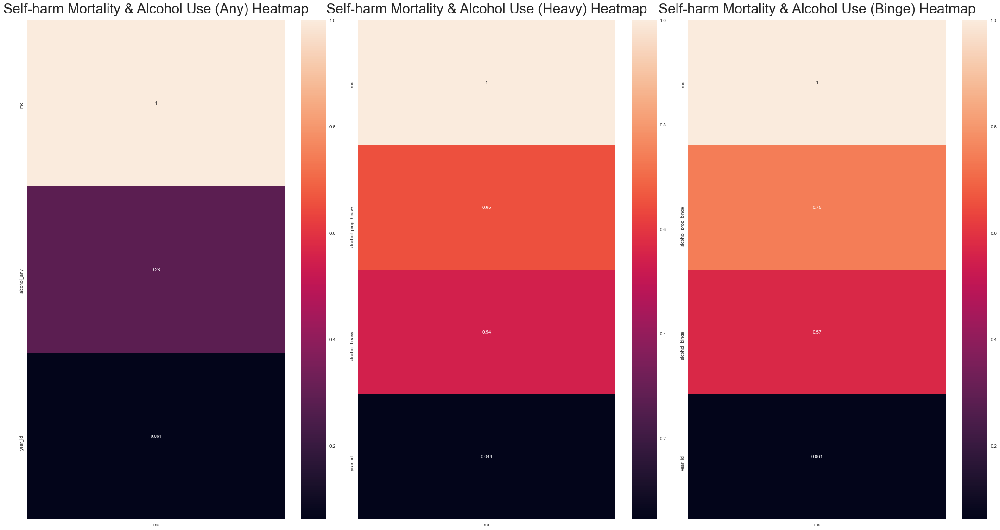

In [23]:
fig, ax = plt.subplots(1, 3, figsize=(30, 16))
sns.heatmap(harm_alcohol_any.corr()[['mx']].sort_values(by='mx', ascending=False), annot=True, ax=ax[0])
ax[0].set_title('Self-harm Mortality & Alcohol Use (Any) Heatmap', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.heatmap(harm_alcohol_heavy.corr()[['mx']].sort_values(by='mx', ascending=False), annot=True, ax=ax[1])
ax[1].set_title('Self-harm Mortality & Alcohol Use (Heavy) Heatmap', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
sns.heatmap(harm_alcohol_binge.corr()[['mx']].sort_values(by='mx', ascending=False), annot=True, ax=ax[2])
ax[2].set_title('Self-harm Mortality & Alcohol Use (Binge) Heatmap', fontdict={'fontsize': 30, 'fontweight': 25}, pad=15)
plt.tight_layout();

### Figure Summary

There is a light association between any alcohol use and self-harm mortality, but the strongest correlations are seen between heavy and binge drinking, with the prop_binge and prop_heavy being the highest. 

It is important here to note the difference between the alcohol_heavy/alcohol_prop_heavy and between alcohol_binge and alcohol_prop_binge. The first is just the prevalence of that category of drinking in a particular county (by year and by sex). Prop represents the "proportion of all drinkers who are heavy or binge drinkers".

What is striking to me is the difference between `alcohol_binge` and `alcohol_prop_binge` compared to `alcohol_heavy` vs `alcohol_prop_heavy`. The difference between the latter of 0.18 compared to 0.11 is larger than I might have expected. 

Also interesting is the low value of `year_id` - in a dataset this large, there must not be a strong relationship between the year and the rate, or it is otherwise obfuscated by other relationships in the dataset (such as between sex or state or county)

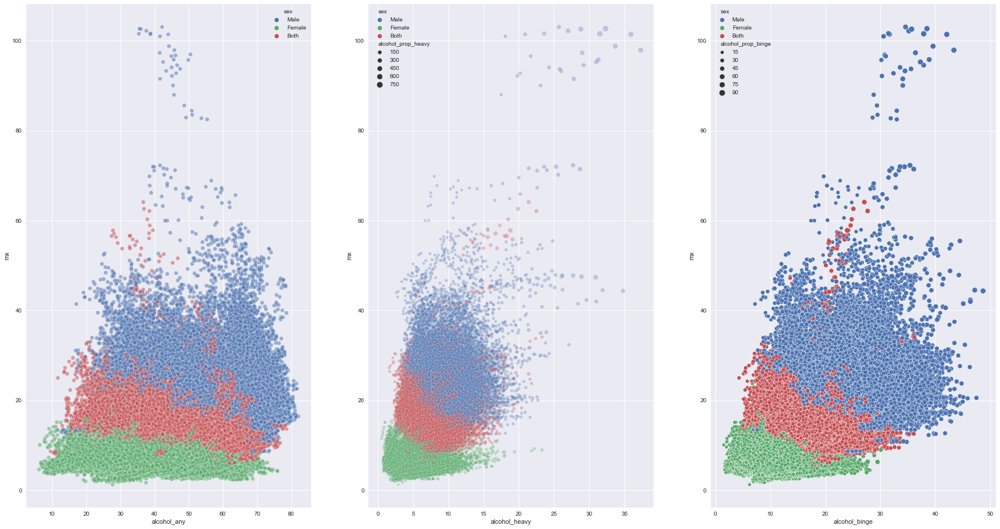

In [149]:
fig, ax = plt.subplots(1, 3, figsize=(30, 16))
sns.scatterplot(x=harm_alcohol_any['alcohol_any'], y=harm_alcohol_any['mx'], hue=harm_alcohol_any['sex'], ax=ax[0], alpha=0.5)
sns.scatterplot(x=harm_alcohol_heavy['alcohol_heavy'], y=harm_alcohol_heavy['mx'], hue=harm_alcohol_heavy['sex'], size=(harm_alcohol_heavy['alcohol_prop_heavy']**2 / 10), alpha=0.3, ax=ax[1])
sns.scatterplot(x=harm_alcohol_binge['alcohol_binge'], y=harm_alcohol_binge['mx'], hue=harm_alcohol_binge['sex'], size=harm_alcohol_binge['alcohol_prop_binge'], ax=ax[2]);

In [151]:
# sns.stripplot(x=harm_alcohol_any['alcohol_any'], y=harm_alcohol_any['mx'], hue=harm_alcohol_any['sex'],jitter=0.25, size=8, linewidth=.5)

### Scatterplot Summary


## Next Steps:

Now that the datasets have been explored, we can think about what kind of analysis to perform. In terms of quantifying the relationship between alcohol use and selfharm mortality rate, I think modeling should include the following:

1) Simple Univariate Linear Regression - These can serve as our baseline.

2) Alternate Regression Model(s) - These will be multivariate, and may include some OHE to try and see if the variance in mortality rate can better be explained by the state or sex variables than by the alcohol use prevalence alone. 

Looking at some of the choropleth maps that were drawn above, I want to see if we can create some unsupervised learning models to cluster similarly affected counties together. Perhaps a map visual of clustered counties will show more apparently any geographic clusters that merit further investigation. 

4) K-Means Clustering